<a href="https://colab.research.google.com/github/ArkhipovAS/GB.Java/blob/master/2024_06_01_UII_soltorg_003.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


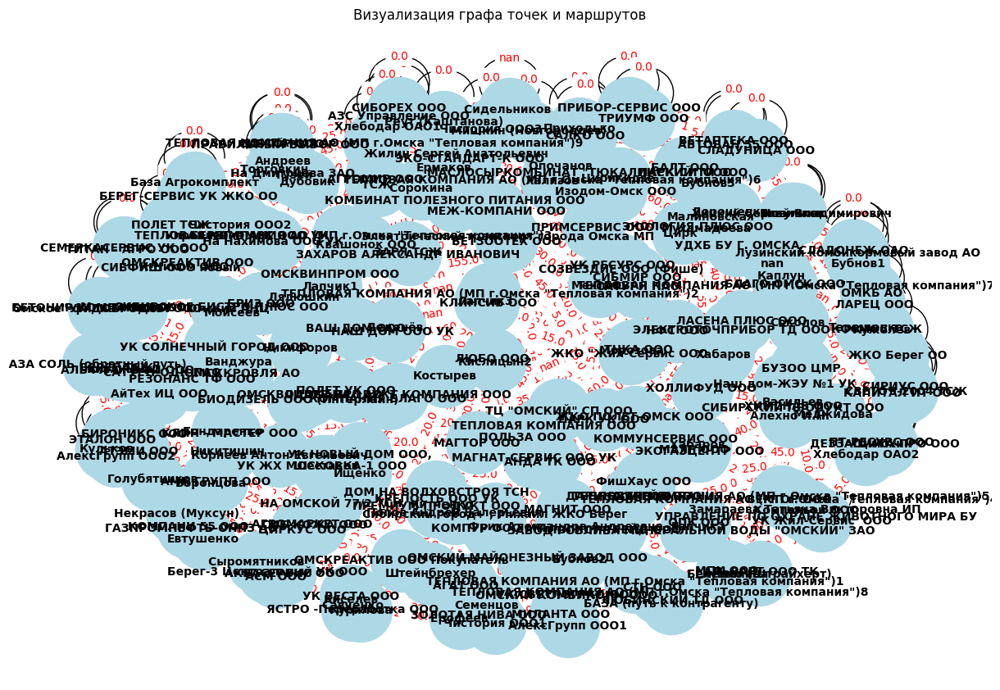

In [2]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Шаг 1: Загрузка данных
file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/step4_addr_coord_time.csv'
df = pd.read_csv(file_path)

# Преобразование времени в числовой формат, если оно не является числовым
df['Time'] = pd.to_numeric(df['Time'], errors='coerce')

# Шаг 2: Получение уникальных точек
unique_points = pd.unique(df[['Point A', 'Point B']].values.ravel('K'))

# Шаг 3: Создание графа
G = nx.Graph()

# Шаг 4: Добавление узлов (точек) в граф
for point in unique_points:
    G.add_node(point)

# Шаг 5: Добавление ребер (маршрутов) в граф
for _, row in df.iterrows():
    point_a = row['Point A']
    point_b = row['Point B']
    time = float(row['Time'])
    G.add_edge(point_a, point_b, time=time)

In [3]:
# Шаг 6: Сохранение графа в файл формата GraphML
graphml_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/graph.graphml'
nx.write_graphml(G, graphml_file_path)

print(f"Граф сохранен в файл {graphml_file_path}")

Граф сохранен в файл /content/drive/MyDrive/ai/internship_2024_06/2024_06_10/graph.graphml


In [ ]:
# Шаг 7: Загрузка графа из файла формата GraphML
graphml_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/graph.graphml'
G = nx.read_graphml(graphml_file_path)

In [ ]:
# Шаг 8: Визуализация графа
pos = nx.spring_layout(G)  # Позиции узлов для визуализации
edge_labels = nx.get_edge_attributes(G, 'time')

plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, node_size=3000, node_color='lightblue', font_size=10, font_weight='bold')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_color='red')
plt.title("Визуализация графа точек и маршрутов")
plt.show()

In [10]:
pip install python-louvain


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


ValueError: 'c' argument has 456 elements, which is inconsistent with 'x' and 'y' with size 233.

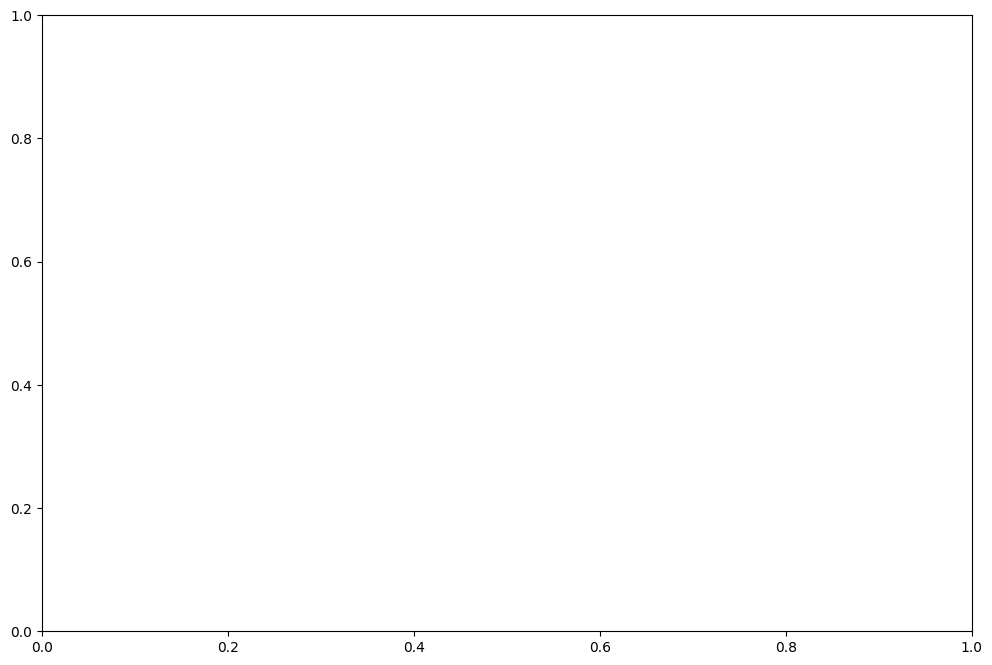

In [25]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import numpy as np  # Добавляем этот импорт

# Шаг 1: Загрузка данных
file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/step4_addr_coord_time.csv'
df = pd.read_csv(file_path)

# Преобразование времени в числовой формат
df['Time'] = pd.to_numeric(df['Time'], errors='coerce')

# Шаг 2: Создание графа
G = nx.Graph()

# Шаг 3: Добавление узлов (точек) в граф
for _, row in df.iterrows():
    point_a = row['Point A']
    point_b = row['Point B']
    G.add_node(point_a)
    G.add_node(point_b)
    G.add_edge(point_a, point_b)

# Шаг 4: Кластеризация графа с использованием алгоритма KMeans
# Создаем матрицу признаков узлов графа (в данном случае - координаты точек)
features = []
for node in G.nodes:
    point_a_long = df.loc[df['Point A'] == node, 'Point A Longitude'].values
    point_a_lat = df.loc[df['Point A'] == node, 'Point A Latitude'].values
    if len(point_a_long) > 0 and len(point_a_lat) > 0:
        features.append([point_a_long[0], point_a_lat[0]])

    point_b_long = df.loc[df['Point B'] == node, 'Point B Longitude'].values
    point_b_lat = df.loc[df['Point B'] == node, 'Point B Latitude'].values
    if len(point_b_long) > 0 and len(point_b_lat) > 0:
        features.append([point_b_long[0], point_b_lat[0]])

# Преобразуем в numpy массив
features = np.array(features)

# Удаление строк с отсутствующими значениями (NaN)
features = features[~np.isnan(features).any(axis=1)]

# Количество кластеров
n_clusters = 5

# Применяем алгоритм KMeans
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(features)

# Шаг 5: Визуализация кластеров
# Визуализация кластеров
plt.figure(figsize=(12, 8))

# Получаем метки кластеров для каждого узла
cluster_labels = kmeans.labels_

# Создаем массив цветов для каждого узла
node_colors = [colors[label % len(colors)] for label in cluster_labels]

# Рисуем узлы, раскрашивая их в соответствии с кластерами, которым они принадлежат
nx.draw_networkx_nodes(G, pos, node_size=300, node_color=node_colors)
# Рисуем ребра
nx.draw_networkx_edges(G, pos, alpha=0.5)

# Добавляем подписи узлов
nx.draw_networkx_labels(G, pos, font_size=6, font_weight='bold')

plt.title("Кластеризация графа с использованием алгоритма KMeans")
plt.show()


In [26]:
print("Количество узлов в графе:", len(G.nodes))
print("Длина массива цветов:", len(node_colors))


Количество узлов в графе: 233
Длина массива цветов: 456


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


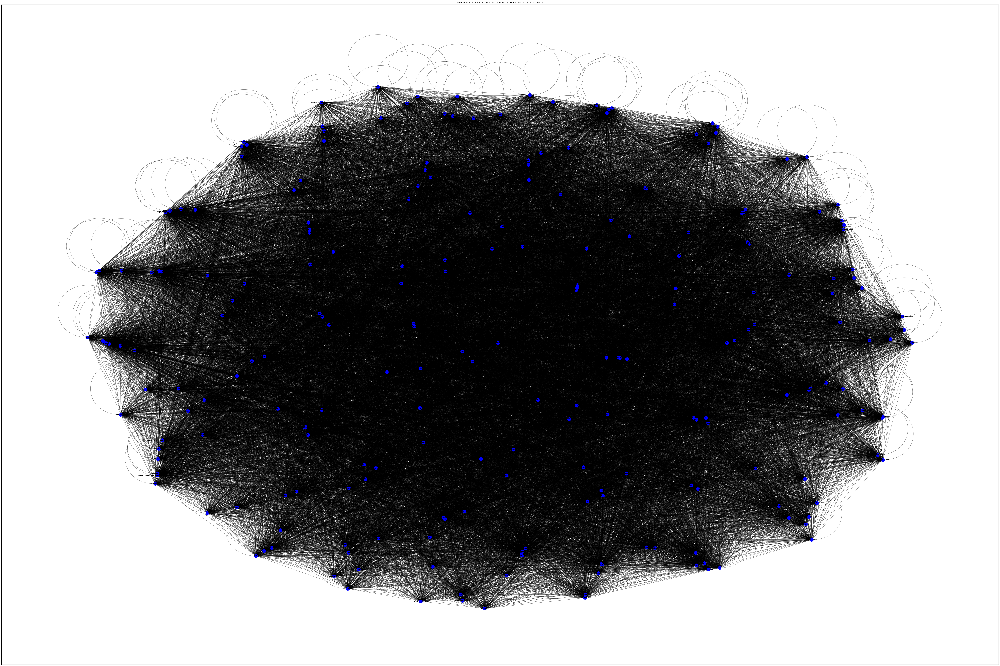

In [35]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import numpy as np

# Шаг 1: Загрузка данных
file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/step4_addr_coord_time.csv'
df = pd.read_csv(file_path)

# Преобразование времени в числовой формат
df['Time'] = pd.to_numeric(df['Time'], errors='coerce')

# Шаг 2: Создание графа
G = nx.Graph()

# Шаг 3: Добавление узлов (точек) в граф
for _, row in df.iterrows():
    point_a = row['Point A']
    point_b = row['Point B']
    G.add_node(point_a)
    G.add_node(point_b)
    G.add_edge(point_a, point_b)

# Шаг 4: Кластеризация графа с использованием алгоритма KMeans
# Создаем матрицу признаков узлов графа (в данном случае - координаты точек)
features = []
for node in G.nodes:
    point_a_long = df.loc[df['Point A'] == node, 'Point A Longitude'].values
    point_a_lat = df.loc[df['Point A'] == node, 'Point A Latitude'].values
    if len(point_a_long) > 0 and len(point_a_lat) > 0:
        features.append([point_a_long[0], point_a_lat[0]])

    point_b_long = df.loc[df['Point B'] == node, 'Point B Longitude'].values
    point_b_lat = df.loc[df['Point B'] == node, 'Point B Latitude'].values
    if len(point_b_long) > 0 and len(point_b_lat) > 0:
        features.append([point_b_long[0], point_b_lat[0]])

# Преобразуем в numpy массив
features = np.array(features)

# Удаление строк с отсутствующими значениями (NaN)
features = features[~np.isnan(features).any(axis=1)]

# Количество кластеров
n_clusters = 5

# Применяем алгоритм KMeans
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(features)
cluster_labels = kmeans.labels_

# Создаем цвет для всех узлов
node_color = 'b'

# Шаг 5: Визуализация графа с одним цветом для всех узлов
plt.figure(figsize=(90, 60))

# Позиции узлов для визуализации
pos = nx.spring_layout(G)

# Рисуем узлы, используя один цвет для всех узлов
nx.draw_networkx_nodes(G, pos, node_size=300, node_color=node_color)
# Рисуем ребра
nx.draw_networkx_edges(G, pos, alpha=0.5)

# Добавляем подписи узлов
nx.draw_networkx_labels(G, pos, font_size=6, font_weight='bold')

plt.title("Визуализация графа с использованием одного цвета для всех узлов")
plt.show()


In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Шаг 1: Загрузка данных
file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/step4_addr_coord_time.csv'
df = pd.read_csv(file_path)

# Преобразование времени в числовой формат, если оно не является числовым
df['Time'] = pd.to_numeric(df['Time'], errors='coerce')

# Шаг 2: Получение уникальных точек
unique_points = pd.unique(df[['Point A', 'Point B']].values.ravel('K'))

# Шаг 3: Создание графа
G = nx.Graph()

# Шаг 4: Добавление узлов (точек) в граф
for point in unique_points:
    G.add_node(point)

# Шаг 5: Добавление ребер (маршрутов) в граф
for _, row in df.iterrows():
    point_a = row['Point A']
    point_b = row['Point B']
    time = float(row['Time'])
    G.add_edge(point_a, point_b, time=time)

# Шаг 7: Сохранение графа в файл формата GraphML
graphml_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/graph.graphml'
nx.write_graphml(G, graphml_file_path)

print(f"Граф сохранен в файл {graphml_file_path}")

# Шаг 1: Загрузка графа из файла формата GraphML
graphml_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/graph.graphml'
G = nx.read_graphml(graphml_file_path)

In [97]:
import pandas as pd
import random

# Шаг 1: Загрузка данных о точках
points_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/step3_point_addr_coord.csv'
points_df = pd.read_csv(points_file_path)

# Получаем список заказчиков
customers = points_df['namePoint'].unique().tolist()

# Шаг 2: Создание списка заказов
orders = []

# Проверка на количество заказов
while len(orders) < 4:
    # Выбираем случайного заказчика
    customer = random.choice(customers)
    # Генерируем случайный вес для заказа (кратный 100) от 100 до 3000 кг
    order_weight = random.randint(1, 30) * 100
    orders.append({'Customer': customer, 'Weight': order_weight})
    # Удаляем выбранного заказчика из списка, чтобы не повторяться
    customers.remove(customer)

# Шаг 3: Вывод списка заказов
print("Список заказов:")
for order in orders:
    print(f"Заказчик: {order['Customer']}, Вес: {order['Weight']} кг")

# Шаг 4: Сохранение списка заказов в CSV-файл
orders_df = pd.DataFrame(orders)
orders_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/orders.csv'
orders_df.to_csv(orders_file_path, index=False)

print(f"\nСписок заказов также сохранен в файл {orders_file_path}")


Список заказов:
Заказчик: ПОЛЕТ УК ООО, Вес: 2700 кг
Заказчик: Кислицын1, Вес: 2300 кг
Заказчик: БЕРЕГ-ОМСК ООО УК, Вес: 1100 кг
Заказчик: ПТ-РЕСУРС ООО, Вес: 1200 кг

Список заказов также сохранен в файл /content/drive/MyDrive/ai/internship_2024_06/2024_06_10/orders.csv


In [98]:
import networkx as nx
import pandas as pd

# Загрузка графа маршрутов
graphml_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/graph.graphml'
G = nx.read_graphml(graphml_file_path)

# Загрузка списка заказов
orders_file_path = '/content/drive/MyDrive/ai/internship_2024_06/2024_06_10/orders.csv'
orders_df = pd.read_csv(orders_file_path)

print("Список заказов:")
print(orders_df)

# Определение веса машины
max_capacity = 6000  # Вместимость машины в кг

# Создание списка точек маршрута с временем и весом машины
route = [('БАЗА (путь к контрагенту)', 0, max_capacity)]

# Общий вес заказов
total_weight = 0

# Начало обхода графа
current_node = 'БАЗА (путь к контрагенту)'
next_node = None

# Список всех заказов, которые нужно доставить
orders_to_deliver = orders_df.values.tolist()

point_number = 1

while orders_to_deliver:
    min_distance = float('inf')
    next_order_node = None

    for order in orders_to_deliver:
        order_node = order[0]

        try:
            distance = nx.shortest_path_length(G, current_node, order_node, weight='time')
            if distance < min_distance:
                min_distance = distance
                next_order_node = order_node
        except nx.NetworkXNoPath:
            # Если пути нет, переходим к следующему заказу
            continue

    if next_order_node:
        # Добавляем узел заказа в маршрут
        route.append((next_order_node, min_distance, total_weight))

        # Добавляем вес заказа к общему весу
        order_weight = orders_df.loc[orders_df['Customer'] == next_order_node, 'Weight'].iloc[0]
        total_weight += order_weight

        # Удаляем доставленный заказ из списка
        orders_to_deliver = [order for order in orders_to_deliver if order[0] != next_order_node]

        # Если машина загружена, возвращаемся на базу
        if total_weight >= max_capacity:
            # Добавляем точку возврата на базу
            return_to_base_distance = nx.shortest_path_length(G, current_node, 'БАЗА СОЛЬ (обратный путь)', weight='time')
            route.append(('БАЗА СОЛЬ (обратный путь)', return_to_base_distance, 0))
            break

        # Переходим к следующему заказу
        current_node = next_order_node
    else:
        # Если не удалось найти путь для заказа, выходим из цикла
        break

    # Увеличиваем номер точки маршрута
    point_number += 1

print("\nМаршрут доставки заказов:")
for i, (node, time, weight) in enumerate(route):
    # Учитываем суммарный вес заказов в машине
    total_weight_in_node = total_weight - weight
    print(f"Точка {i+1}: {node}, Время: {time}, Вес машины: {total_weight_in_node if total_weight_in_node >= 0 else 0} кг")


Список заказов:
            Customer  Weight
0       ПОЛЕТ УК ООО    2700
1          Кислицын1    2300
2  БЕРЕГ-ОМСК ООО УК    1100
3      ПТ-РЕСУРС ООО    1200

Маршрут доставки заказов:
Точка 1: БАЗА (путь к контрагенту), Время: 0, Вес машины: 200 кг
Точка 2: Кислицын1, Время: 10.0, Вес машины: 6200 кг
Точка 3: ПОЛЕТ УК ООО, Время: 15.0, Вес машины: 3900 кг
Точка 4: ПТ-РЕСУРС ООО, Время: 15.0, Вес машины: 1200 кг
Точка 5: БАЗА СОЛЬ (обратный путь), Время: 10.0, Вес машины: 6200 кг
